# Detecting Fake Satellite Imagery



## References:



# Load Packages

In [1]:
import sys
import sklearn
import os
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
from functools import partial
import PIL
import PIL.Image
from google.colab import files
from google.colab import drive # Crucial for google drive mount

%tensorflow_version 2.x
import tensorflow as tf
from tensorflow import keras

np.random.seed(42) # note that you must use the same seed to ensure consistentcy in your training/validation/testing
tf.random.set_seed(42)

In [2]:
## From M6.2

try:
    # %tensorflow_version only exists in Colab.
    %tensorflow_version 2.x
    IS_COLAB = True
except Exception:
    IS_COLAB = False

if not tf.config.list_physical_devices('GPU'):
    print("No GPU was detected. CNNs can be very slow without a GPU.")
    if IS_COLAB:
        print("Go to Runtime > Change runtime and select a GPU hardware accelerator.")

# To plot pretty figures
%matplotlib inline
import matplotlib as mpl
import matplotlib.pyplot as plt
mpl.rc('axes', labelsize=14)
mpl.rc('xtick', labelsize=12)
mpl.rc('ytick', labelsize=12)

# Where to save the figures
PROJECT_ROOT_DIR = "."
CHAPTER_ID = "cnn"
IMAGES_PATH = os.path.join(PROJECT_ROOT_DIR, "images", CHAPTER_ID)
os.makedirs(IMAGES_PATH, exist_ok=True)


## Utility functions from Module 6.2 Tutorial

def save_fig(fig_id, tight_layout=True, fig_extension="png", resolution=300):
    path = os.path.join(IMAGES_PATH, fig_id + "." + fig_extension)
    print("Saving figure", fig_id)
    if tight_layout:
        plt.tight_layout()
    plt.savefig(path, format=fig_extension, dpi=resolution)

def plot_image(image):
    plt.imshow(image, cmap="gray", interpolation="nearest")
    plt.axis("off")

def plot_color_image(image):
    plt.imshow(image, interpolation="nearest")
    plt.axis("off")

No GPU was detected. CNNs can be very slow without a GPU.
Go to Runtime > Change runtime and select a GPU hardware accelerator.


# Import Dataset


NOTE: I tried uploading directly to Collab, as well as pulling from local directory. It was going to take hours. This process, instead, relies on Google Drive. It takes about a half hour to run, so turn on some Netflix.

1) Download the image datasets from the site https://figshare.com/articles/dataset/Fake_Satellite_Imagery/12197655/2?file=22424628. 2) Upload each folder to your Google Drive account associated with your Collab account. 3) "Mount" your Google Drive to your Collab - if successful, you should see the folders show up under the "gdrive" tab on the left panel of your Collab screen. 4) Read images into list through list comprehension -> path -> tensor after combining labels to datasets. 

In [3]:
## Read in the files. Mount your google drive to collab internal directory

#real_tacoma = files.upload() # Not using this. Takes too long.
drive.mount('/content/gdrive')

Mounted at /content/gdrive


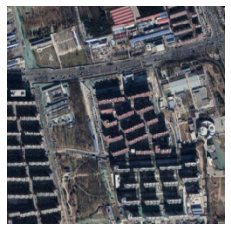

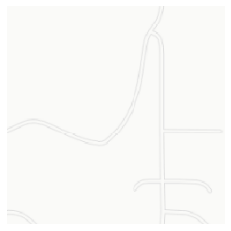

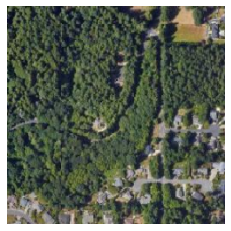

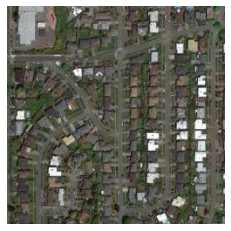

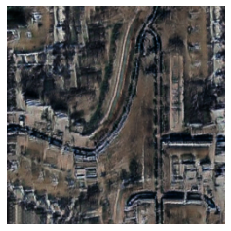

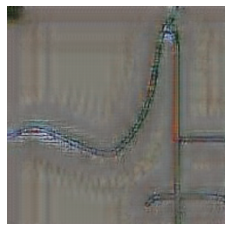

In [5]:
## Test to see if individual images loaded

# Beijing real

image = tf.io.read_file('/content/gdrive/MyDrive/data/authentic/Beijing/10_12401_A_real_A.png')
image = tf.image.decode_image(image, channels=3, expand_animations = False)

image_resized = tf.image.resize(image, [224, 224])
plot_color_image(image_resized/255.0)
plt.show()

# Tacoma base

image = tf.io.read_file('/content/gdrive/MyDrive/data/base/10454_22959.png')
image = tf.image.decode_image(image, channels=3, expand_animations = False)

image_resized = tf.image.resize(image, [224, 224])
plot_color_image(image_resized/255.0)
plt.show()

# Tacoma real

image = tf.io.read_file('/content/gdrive/MyDrive/data/authentic/Tacoma/10454_22959.png')
image = tf.image.decode_image(image, channels=3, expand_animations = False)

image_resized = tf.image.resize(image, [224, 224])
plot_color_image(image_resized/255.0)
plt.show()

# Seattle real

image = tf.io.read_file('/content/gdrive/MyDrive/data/authentic/Seattle/10_22864_A_real_A.png')
image = tf.image.decode_image(image, channels=3, expand_animations = False)

image_resized = tf.image.resize(image, [224, 224])
plot_color_image(image_resized/255.0)
plt.show()

# Tacoma-Beijing-style fake

image = tf.io.read_file('/content/gdrive/MyDrive/data/fake/Beijing_style/10454_22959.jpg')
image = tf.image.decode_image(image, channels=3, expand_animations = False)

image_resized = tf.image.resize(image, [224, 224])
plot_color_image(image_resized/255.0)
plt.show()

# Tacoma-Seattle-style fake

image = tf.io.read_file('/content/gdrive/MyDrive/data/fake/Seattle_style/10454_22959.jpg')
image = tf.image.decode_image(image, channels=3, expand_animations = False)

image_resized = tf.image.resize(image, [224, 224])
plot_color_image(image_resized/255.0)
plt.show()


In [7]:
## Read in folders as lists of png files

beijing_real_list = ['/content/gdrive/MyDrive/data/authentic/Beijing/' + file for file in os.listdir('/content/gdrive/MyDrive/data/authentic/Beijing/')]
tacoma_real_list = ['/content/gdrive/MyDrive/data/authentic/Tacoma/' + file for file in os.listdir('/content/gdrive/MyDrive/data/authentic/Tacoma/')]
seattle_real_list = ['/content/gdrive/MyDrive/data/authentic/Seattle/' + file for file in os.listdir('/content/gdrive/MyDrive/data/authentic/Seattle/')]
tacoma_base_list = ['/content/gdrive/MyDrive/data/base/' + file for file in os.listdir('/content/gdrive/MyDrive/data/base/')]
beijing_fake_list = ['/content/gdrive/MyDrive/data/fake/Beijing_style/' + file for file in os.listdir('/content/gdrive/MyDrive/data/fake/Beijing_style/')]
seattle_fake_list = ['/content/gdrive/MyDrive/data/fake/Seattle_style/' + file for file in os.listdir('/content/gdrive/MyDrive/data/fake/Seattle_style/')]

In [8]:
## Convert lists to paths

beijing_real = tf.data.Dataset.from_tensor_slices(beijing_real_list)
tacoma_real = tf.data.Dataset.from_tensor_slices(tacoma_real_list)
seattle_real = tf.data.Dataset.from_tensor_slices(seattle_real_list)
tacoma_base = tf.data.Dataset.from_tensor_slices(tacoma_base_list)
beijing_fake = tf.data.Dataset.from_tensor_slices(beijing_fake_list)
seattle_fake = tf.data.Dataset.from_tensor_slices(seattle_fake_list)

NOTE: my understanding of the paper is that they ran the model on real images of Beijing, Seattle, and Tacoma, but the fakes were all based off of Tacoma base with Beijing-style characteristics and Seattle-style characteristics. So, I'm considering N_real to be both Beijing, Tacoma, and Seattle real imagery.

NOTE 2: I'm attaching labels because I assume the images don't have labels attached already (they just belong to their corresponding fake vs. real folders).

In [9]:
## Create labels. NOTE: my

N_BJ_real = len(beijing_real)
N_TAC_real= len(tacoma_real)
N_SEA_real= len(seattle_real)
N_base= len(tacoma_base)
N_BJ_fake= len(beijing_fake)
N_SEA_fake= len(seattle_fake)

N_real = N_BJ_real + N_TAC_real + N_SEA_real
N_fake = N_BJ_fake + N_SEA_fake
N = N_real + N_fake

real_labels = np.ones(N_real)
fake_labels = np.zeros(N_fake)

real_label_ds = tf.data.Dataset.from_tensor_slices(real_labels)
fake_labels_ds = tf.data.Dataset.from_tensor_slices(fake_labels)

In [10]:
## Create real and fake datasets

temp=beijing_real.concatenate(seattle_real).concatenate(tacoma_real)
real_ds=tf.data.Dataset.zip((temp,real_label_ds))

temp=beijing_fake.concatenate(seattle_fake)
fake_ds=tf.data.Dataset.zip((temp,fake_labels_ds))

In [11]:
## Create merged dataset and shuffle

merged_ds = real_ds.concatenate(fake_ds)
merged_ds = merged_ds.shuffle(N)
merged_ds

<ShuffleDataset element_spec=(TensorSpec(shape=(), dtype=tf.string, name=None), TensorSpec(shape=(), dtype=tf.float64, name=None))>

NOTE: the paper says they used 256x256 pixel images, so that's how I resized.

In [12]:
## Utility functions from Module 6.2

def load_image(path, label):
  image = tf.io.read_file(path)
  image = tf.image.decode_image(image, channels=3, expand_animations = False)
  return image, label  # scale the range of pixel values to [0, 1]

def resize_image(size):
  def _resize_image(image, label):
    # return tf.image.resize(image, size), label
    return tf.image.resize_with_pad(image, size[0], size[1], antialias=True), label
  return _resize_image


In [13]:
## Create image dataset

image_ds = merged_ds.map(load_image).map(resize_image((256,256)))

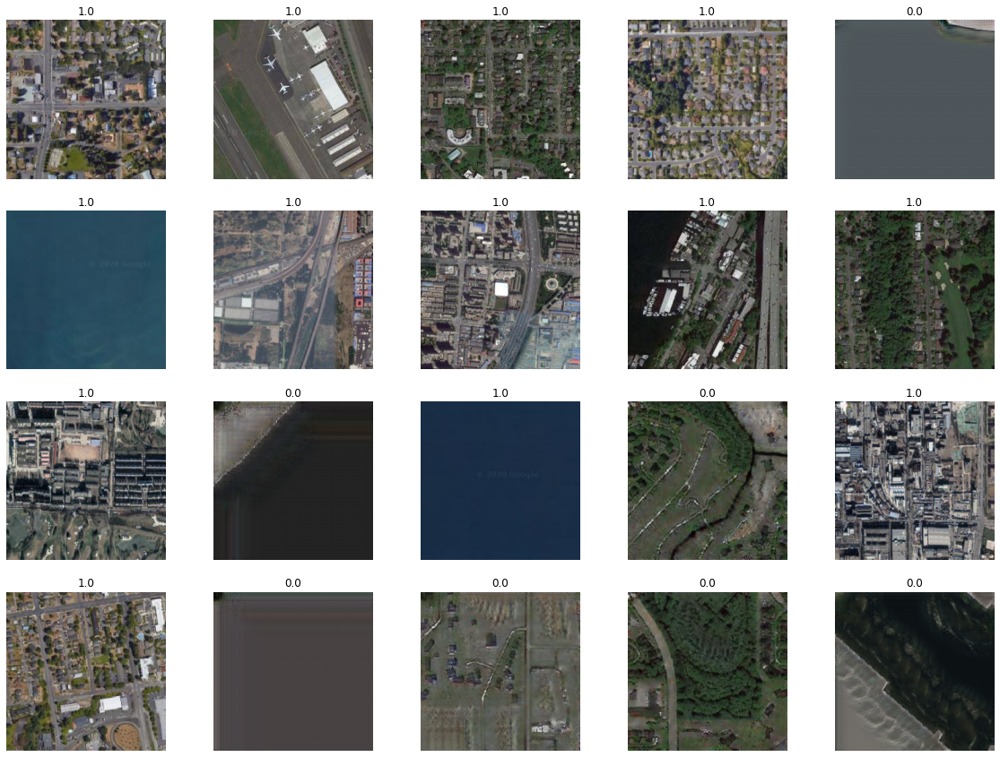

In [14]:
## See what image dataset looks like.

plt.figure(figsize=(20,15))
for i, (image, label) in enumerate(image_ds.take(20)):
  plt.subplot(4,5,i+1)
  plt.imshow(image.numpy()/255.0)
  plt.axis('off')
  plt.title(label.numpy())

NOTE: I'm concerned that some of our fakes are just grey. That might be the "haloing effect" I think I remember reading about. To be revisited...

In [15]:
## Split into training and test sets

N_test = int(0.15*N)
N_val = int(0.15*N)
N_train = N - N_test - N_val

train_ds = image_ds.take(N_train)
test_ds = image_ds.skip(N_train)
val_ds = test_ds.take(N_val)
test_ds = test_ds.skip(N_val)

In [16]:
## Batch data for training

train_ds = train_ds.shuffle(256).batch(20).prefetch(1)
val_ds = val_ds.batch(20).prefetch(1)
test_ds = test_ds.batch(20).prefetch(1)


# *** END OF PROJECT SO FAR. ***

Rest of this notebook is from assignment 2 template.

In [17]:
n_classes = 2
batch_size = 32

base_model = keras.applications.InceptionV3(weights="imagenet",
                                                  include_top=False)
avg = keras.layers.GlobalAveragePooling2D()(base_model.output)
output = keras.layers.Dense(n_classes, activation="softmax")(avg)
model = keras.models.Model(inputs=base_model.input, outputs=output)

87924736/87910968 [==============================] - 0s 0us/step


In [18]:
for layer in base_model.layers:
    layer.trainable = True

optimizer = keras.optimizers.SGD(learning_rate=0.01, momentum=0.9,
                                 nesterov=True, decay=0.001)

model.compile(loss="sparse_categorical_crossentropy", optimizer=optimizer,
              metrics=["accuracy"])

history = model.fit(train_ds,
                    steps_per_epoch=int(len(train_ds) / batch_size),
                    validation_data=val_ds,
                    validation_steps=int(len(val_ds) / batch_size),
                    epochs=20)

Epoch 1/20
8/8 [==============================] - 318s 38s/step - loss: 0.5320 - accuracy: 0.7125 - val_loss: 0.4922 - val_accuracy: 0.7500
Epoch 2/20
8/8 [==============================] - 181s 25s/step - loss: 0.2674 - accuracy: 0.9000 - val_loss: 1.0531 - val_accuracy: 0.6000
Epoch 3/20
8/8 [==============================] - 118s 16s/step - loss: 0.2168 - accuracy: 0.9000 - val_loss: 0.8071 - val_accuracy: 0.7000
Epoch 4/20
8/8 [==============================] - 86s 11s/step - loss: 0.1284 - accuracy: 0.9625 - val_loss: 0.4484 - val_accuracy: 0.7000
Epoch 5/20
8/8 [==============================] - 75s 10s/step - loss: 0.0561 - accuracy: 0.9750 - val_loss: 0.4084 - val_accuracy: 0.8500
Epoch 6/20
8/8 [==============================] - 73s 10s/step - loss: 0.1513 - accuracy: 0.9750 - val_loss: 0.7646 - val_accuracy: 0.8500
Epoch 7/20
8/8 [==============================] - 72s 9s/step - loss: 0.0999 - accuracy: 0.9563 - val_loss: 2.2337 - val_accuracy: 0.7500
Epoch 8/20
8/8 [=========

In [19]:
final_image = keras.applications.inception_v3.preprocess_input(image)

In [20]:
model.evaluate(test_ds)

61/61 [==============================] - 108s 1s/step - loss: 0.1824 - accuracy: 0.9380


[0.1823689341545105, 0.9379652738571167]

# MesoNet

In [ ]:
## Batch data for training
train_ds = image_ds.take(N_train)
test_ds = image_ds.skip(N_train)
val_ds = test_ds.take(N_val)
test_ds = test_ds.skip(N_val)

batch_size=20
dataset_size=N_train

train_ds = train_ds.shuffle(256).repeat().batch(batch_size).prefetch(1)
val_ds = val_ds.batch(batch_size).prefetch(1)

test_ds = test_ds.batch(batch_size).prefetch(1)


## Meso1

In [ ]:
## Utility functions

def predict(model, x):
    if x.size == 0:
        return []
    return model.predict(x)

def fit(model, x, y):
    return model.train_on_batch(x, y)

def get_accuracy(model, x, y):
    return model.test_on_batch(x, y)

def load(model, path):
    model.load_weights(path)

In [ ]:
## Inputs

IMGWIDTH = 256
dl_rate=1
learning_rate = 0.001

## Model

x = keras.layers.Input(shape = (IMGWIDTH, IMGWIDTH, 3))

x1 = keras.layers.Conv2D(16, (3, 3), dilation_rate = dl_rate, strides = 1, padding='same', activation = 'relu')(x)
x1 = keras.layers.Conv2D(4, (1, 1), padding='same', activation = 'relu')(x1)
x1 = keras.layers.BatchNormalization()(x1)
x1 = keras.layers.MaxPooling2D(pool_size=(8, 8), padding='same')(x1)

y = keras.layers.Flatten()(x1)
y = keras.layers.Dropout(0.5)(y)
y = keras.layers.Dense(1, activation = 'sigmoid')(y)
model_meso1=tf.keras.Model(inputs = x, outputs = y)

In [ ]:
## See model


for index, layer in enumerate(model.layers):
    print(index, layer.name)

0 input_4
1 conv2d_98
2 batch_normalization_96
3 max_pooling2d_6
4 conv2d_99
5 batch_normalization_97
6 max_pooling2d_7
7 conv2d_100
8 batch_normalization_98
9 max_pooling2d_8
10 conv2d_101
11 batch_normalization_99
12 max_pooling2d_9
13 flatten_2
14 dropout_2
15 dense_3
16 leaky_re_lu
17 dropout_3
18 dense_4


In [ ]:
## Fit the model

optimizer = keras.optimizers.Adam(lr=learning_rate)
model_meso1.compile(loss="mean_squared_error", optimizer=optimizer,
              metrics=["accuracy"])
history = model_meso1.fit(train_ds,
                    steps_per_epoch=int(0.75 * dataset_size / batch_size), #'''0.75 * ''' 
                    validation_data=val_ds,
                    validation_steps=int(0.15 * dataset_size / batch_size), #'''0.15 * '''
                    epochs=5)


Epoch 1/5


/usr/local/lib/python3.7/dist-packages/keras/optimizer_v2/adam.py:105: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(Adam, self).__init__(name, **kwargs)


211/211 [==============================] - 27s 122ms/step - loss: 0.1000 - accuracy: 0.8777 - val_loss: 0.1043 - val_accuracy: 0.8738
Epoch 2/5
211/211 [==============================] - 26s 125ms/step - loss: 0.0908 - accuracy: 0.8886 - val_loss: 0.2718 - val_accuracy: 0.6917
Epoch 3/5
211/211 [==============================] - 26s 122ms/step - loss: 0.0895 - accuracy: 0.8889 - val_loss: 0.0574 - val_accuracy: 0.9274
Epoch 4/5
211/211 [==============================] - 26s 123ms/step - loss: 0.0750 - accuracy: 0.9081 - val_loss: 0.0647 - val_accuracy: 0.9202
Epoch 5/5
211/211 [==============================] - 26s 123ms/step - loss: 0.0693 - accuracy: 0.9111 - val_loss: 0.0631 - val_accuracy: 0.9107


dict_keys(['loss', 'accuracy', 'val_loss', 'val_accuracy'])


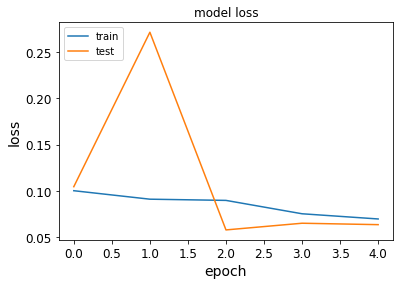

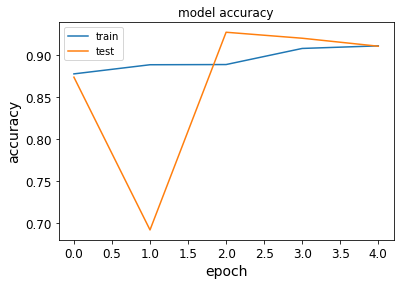

In [ ]:
## Plot history: accuracy and loss

# list all data in history
print(history.history.keys())
# summarize history for loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()
# summarize history for accuracy
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

In [ ]:
model_meso1.evaluate(test_ds)

61/61 [==============================] - 18s 49ms/step - loss: 0.0616 - accuracy: 0.9198


[0.061600130051374435, 0.9197683930397034]

## Meso4

In [ ]:
## Meso4 model

x = keras.layers.Input(shape = (IMGWIDTH, IMGWIDTH, 3))

x1 = keras.layers.Conv2D(8, (3, 3), padding='same', activation = 'relu')(x)
x1 = keras.layers.BatchNormalization()(x1)
x1 = keras.layers.MaxPooling2D(pool_size=(2, 2), padding='same')(x1)

x2 = keras.layers.Conv2D(8, (5, 5), padding='same', activation = 'relu')(x1)
x2 = keras.layers.BatchNormalization()(x2)
x2 = keras.layers.MaxPooling2D(pool_size=(2, 2), padding='same')(x2)

x3 = keras.layers.Conv2D(16, (5, 5), padding='same', activation = 'relu')(x2)
x3 = keras.layers.BatchNormalization()(x3)
x3 = keras.layers.MaxPooling2D(pool_size=(2, 2), padding='same')(x3)

x4 = keras.layers.Conv2D(16, (5, 5), padding='same', activation = 'relu')(x3)
x4 = keras.layers.BatchNormalization()(x4)
x4 = keras.layers.MaxPooling2D(pool_size=(4, 4), padding='same')(x4)

y = keras.layers.Flatten()(x4)
y = keras.layers.Dropout(0.5)(y)
y = keras.layers.Dense(16)(y)
y = keras.layers.LeakyReLU(alpha=0.1)(y)
y = keras.layers.Dropout(0.5)(y)
y = keras.layers.Dense(1, activation = 'sigmoid')(y)

model_meso4=tf.keras.Model(inputs = x, outputs = y)

In [ ]:
## Fit the model

optimizer = keras.optimizers.Adam(lr=learning_rate)
model_meso4.compile(loss="mean_squared_error", optimizer=optimizer,
              metrics=["accuracy"])
history = model_meso4.fit(train_ds,
                    steps_per_epoch=int(0.75 * dataset_size / batch_size), #'''0.75 * ''' 
                    validation_data=val_ds,
                    validation_steps=int(0.15 * dataset_size / batch_size), #'''0.15 * '''
                    epochs=5)


Epoch 1/5


/usr/local/lib/python3.7/dist-packages/keras/optimizer_v2/adam.py:105: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(Adam, self).__init__(name, **kwargs)


211/211 [==============================] - 28s 125ms/step - loss: 0.1784 - accuracy: 0.7647 - val_loss: 0.1117 - val_accuracy: 0.8405
Epoch 2/5
211/211 [==============================] - 26s 122ms/step - loss: 0.1043 - accuracy: 0.8604 - val_loss: 0.0703 - val_accuracy: 0.8964
Epoch 3/5
211/211 [==============================] - 26s 124ms/step - loss: 0.0890 - accuracy: 0.8827 - val_loss: 0.0723 - val_accuracy: 0.8976
Epoch 4/5
211/211 [==============================] - 26s 122ms/step - loss: 0.0745 - accuracy: 0.9017 - val_loss: 0.0785 - val_accuracy: 0.8893
Epoch 5/5
211/211 [==============================] - 26s 122ms/step - loss: 0.0688 - accuracy: 0.9097 - val_loss: 0.0362 - val_accuracy: 0.9512


dict_keys(['loss', 'accuracy', 'val_loss', 'val_accuracy'])


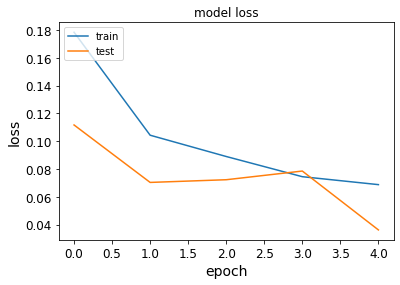

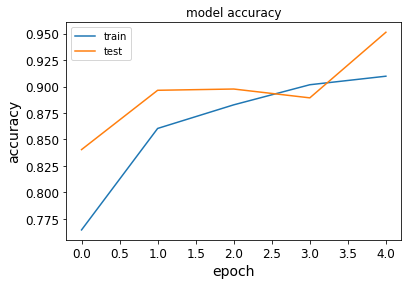

In [ ]:
## Plot history: accuracy and loss

# list all data in history
print(history.history.keys())
# summarize history for loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()
# summarize history for accuracy
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

In [ ]:
model_meso4.evaluate(test_ds)

61/61 [==============================] - 20s 51ms/step - loss: 0.0371 - accuracy: 0.9487


[0.037130191922187805, 0.9487179517745972]

## MesoInception4

In [ ]:
## Function for adding inception block

def InceptionLayer(a, b, c, d):
  def func(x):
    x1 = keras.layers.Conv2D(a, (1, 1), padding='same', activation='relu')(x)

    x2 = keras.layers.Conv2D(b, (1, 1), padding='same', activation='relu')(x)
    x2 = keras.layers.Conv2D(b, (3, 3), padding='same', activation='relu')(x2)

    x3 = keras.layers.Conv2D(c, (1, 1), padding='same', activation='relu')(x)
    x3 = keras.layers.Conv2D(c, (3, 3), dilation_rate = 2, strides = 1, padding='same', activation='relu')(x3)

    x4 = keras.layers.Conv2D(d, (1, 1), padding='same', activation='relu')(x)
    x4 = keras.layers.Conv2D(d, (3, 3), dilation_rate = 3, strides = 1, padding='same', activation='relu')(x4)

    y = tf.keras.layers.Concatenate(axis = -1)([x1, x2, x3, x4])
    
    return y

  return func

In [ ]:
## Build model

x = keras.layers.Input(shape = (IMGWIDTH, IMGWIDTH, 3))

x1 = InceptionLayer(1, 4, 4, 2)(x)
x1 = keras.layers.BatchNormalization()(x1)
x1 = keras.layers.MaxPooling2D(pool_size=(2, 2), padding='same')(x1)

x2 = InceptionLayer(2, 4, 4, 2)(x1)
x2 = keras.layers.BatchNormalization()(x2)
x2 = keras.layers.MaxPooling2D(pool_size=(2, 2), padding='same')(x2)        

x3 = keras.layers.Conv2D(16, (5, 5), padding='same', activation = 'relu')(x2)
x3 = keras.layers.BatchNormalization()(x3)
x3 = keras.layers.MaxPooling2D(pool_size=(2, 2), padding='same')(x3)

x4 = keras.layers.Conv2D(16, (5, 5), padding='same', activation = 'relu')(x3)
x4 = keras.layers.BatchNormalization()(x4)
x4 = keras.layers.MaxPooling2D(pool_size=(4, 4), padding='same')(x4)

y = keras.layers.Flatten()(x4)
y = keras.layers.Dropout(0.5)(y)
y = keras.layers.Dense(16)(y)
y = keras.layers.LeakyReLU(alpha=0.1)(y)
y = keras.layers.Dropout(0.5)(y)
y = keras.layers.Dense(1, activation = 'sigmoid')(y)

model_mesoinception4=tf.keras.Model(inputs = x, outputs = y)

In [ ]:
## Fit the model

optimizer = keras.optimizers.Adam(lr=learning_rate)
model_mesoinception4.compile(loss="mean_squared_error", optimizer=optimizer,
              metrics=["accuracy"])
history = model_mesoinception4.fit(train_ds,
                    steps_per_epoch=int(0.75 * dataset_size / batch_size), #'''0.75 * ''' 
                    validation_data=val_ds,
                    validation_steps=int(0.15 * dataset_size / batch_size), #'''0.15 * '''
                    epochs=5)

Epoch 1/5


/usr/local/lib/python3.7/dist-packages/keras/optimizer_v2/adam.py:105: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(Adam, self).__init__(name, **kwargs)


211/211 [==============================] - 31s 135ms/step - loss: 0.2004 - accuracy: 0.7469 - val_loss: 0.3581 - val_accuracy: 0.5964
Epoch 2/5
211/211 [==============================] - 28s 132ms/step - loss: 0.0988 - accuracy: 0.8746 - val_loss: 0.0828 - val_accuracy: 0.8893
Epoch 3/5
211/211 [==============================] - 28s 133ms/step - loss: 0.0760 - accuracy: 0.9000 - val_loss: 0.0627 - val_accuracy: 0.9274
Epoch 4/5
211/211 [==============================] - 28s 133ms/step - loss: 0.0645 - accuracy: 0.9159 - val_loss: 0.2465 - val_accuracy: 0.7286
Epoch 5/5
211/211 [==============================] - 28s 133ms/step - loss: 0.0593 - accuracy: 0.9256 - val_loss: 0.0627 - val_accuracy: 0.9107


dict_keys(['loss', 'accuracy', 'val_loss', 'val_accuracy'])


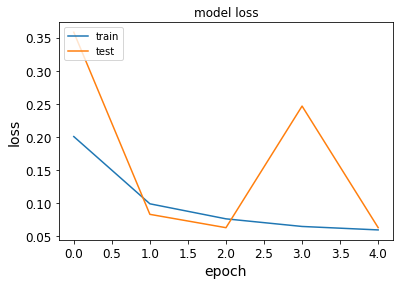

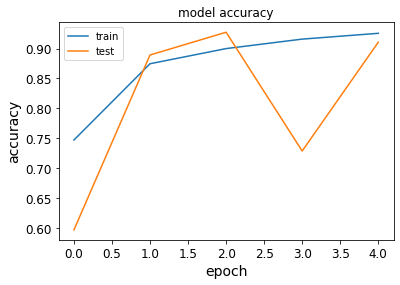

In [ ]:
## Plot history: accuracy and loss

# list all data in history
print(history.history.keys())
# summarize history for loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()
# summarize history for accuracy
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

In [ ]:
model_mesoinception4.evaluate(test_ds)

61/61 [==============================] - 23s 69ms/step - loss: 0.0557 - accuracy: 0.9165


[0.05574708804488182, 0.916459858417511]

Activation Maximization

In [ ]:
layer = model.get_layer(name="conv2d")
feature_extractor = keras.Model(inputs=model.inputs, outputs=layer.output)

In [ ]:
# "loss" will be maximized in the gradient ascent process
def compute_loss(input_image, filter_index):
    activation = feature_extractor(input_image)
    # We avoid border artifacts by only involving non-border pixels in the loss.
    filter_activation = activation[:, 2:-2, 2:-2, filter_index]
    return tf.reduce_mean(filter_activation)

In [ ]:
@tf.function
def gradient_ascent_step(img, filter_index, learning_rate):
    with tf.GradientTape() as tape:
        tape.watch(img)
        loss = compute_loss(img, filter_index)
    # Compute gradients.
    grads = tape.gradient(loss, img)
    # Normalize gradients.
    grads = tf.math.l2_normalize(grads)
    img += learning_rate * grads
    return loss, img

In [ ]:
# The dimensions of our input image
img_width = 256
img_height = 256

def initialize_image():
    # We start from a gray image with some random noise
    img = tf.random.uniform((1, img_width, img_height, 3))
    # ResNet50V2 expects inputs in the range [-1, +1].
    # Here we scale our random inputs to [-0.125, +0.125]
    return (img - 0.5) * 0.25


def visualize_filter(filter_index):
    # We run gradient ascent for 20 steps
    iterations = 100
    learning_rate = 10.0
    img = initialize_image()
    for iteration in range(iterations):
        loss, img = gradient_ascent_step(img, filter_index, learning_rate)

    # Decode the resulting input image
    img = deprocess_image(img[0].numpy())
    return loss, img


def deprocess_image(img):
    # Normalize array: center on 0., ensure variance is 0.15
    img -= img.mean()
    img /= img.std() + 1e-5
    img *= 0.15

    # Center crop
    img = img[25:-25, 25:-25, :]

    # Clip to [0, 1]
    img += 0.5
    img = np.clip(img, 0, 1)

    # Convert to RGB array
    img *= 255
    img = np.clip(img, 0, 255).astype("uint8")
    return img


In [ ]:
model.summary()

Model: "model_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_4 (InputLayer)        [(None, 256, 256, 3)]     0         
                                                                 
 conv2d_98 (Conv2D)          (None, 256, 256, 8)       224       
                                                                 
 batch_normalization_96 (Bat  (None, 256, 256, 8)      32        
 chNormalization)                                                
                                                                 
 max_pooling2d_6 (MaxPooling  (None, 128, 128, 8)      0         
 2D)                                                             
                                                                 
 conv2d_99 (Conv2D)          (None, 128, 128, 8)       1608      
                                                                 
 batch_normalization_97 (Bat  (None, 128, 128, 8)      32  

conv2d_98
batch_normalization_96
max_pooling2d_6
conv2d_99
batch_normalization_97
max_pooling2d_7
conv2d_100
batch_normalization_98
max_pooling2d_8
conv2d_101
batch_normalization_99
max_pooling2d_9


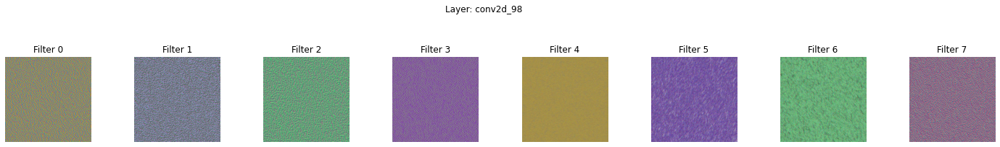

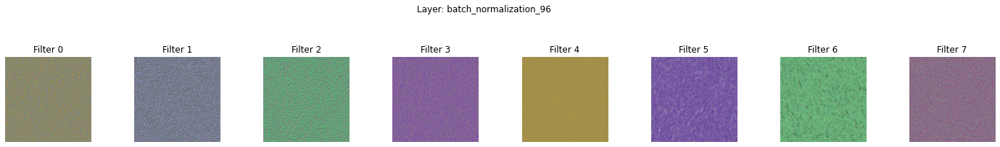

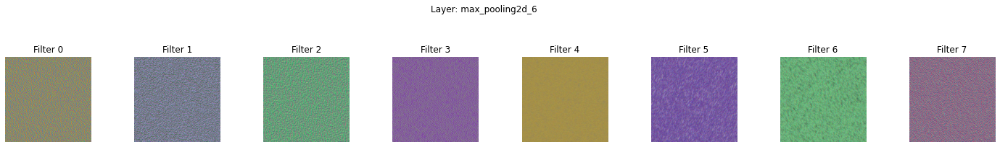

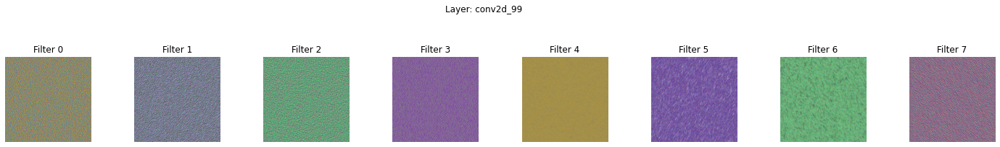

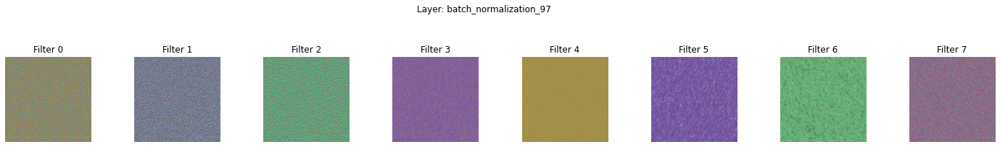

...

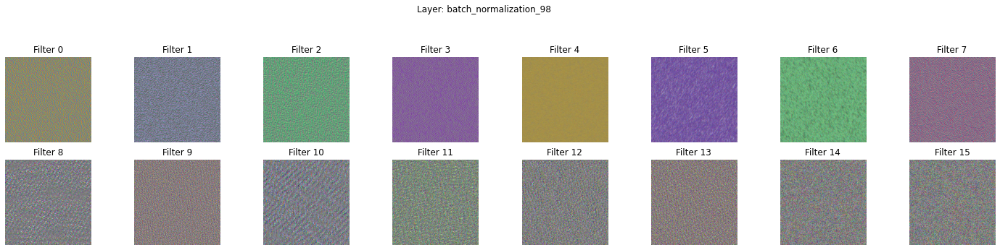

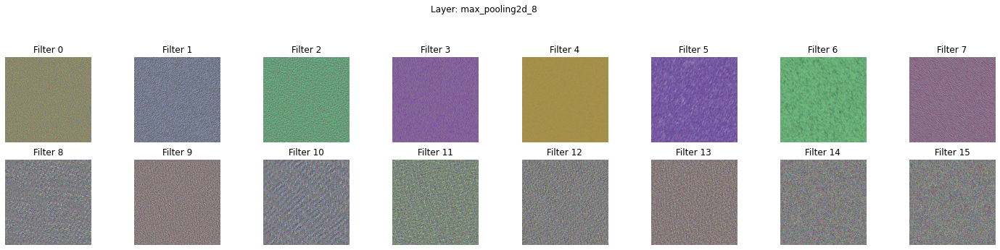

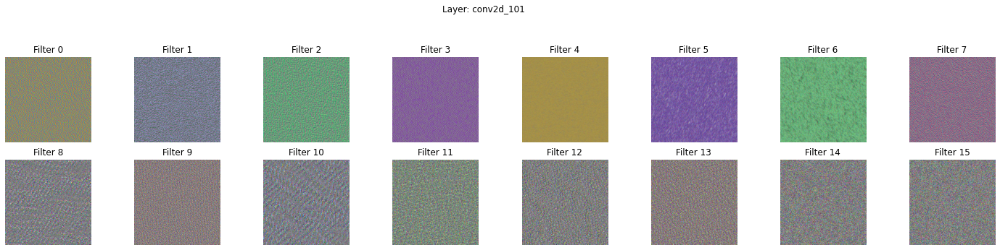

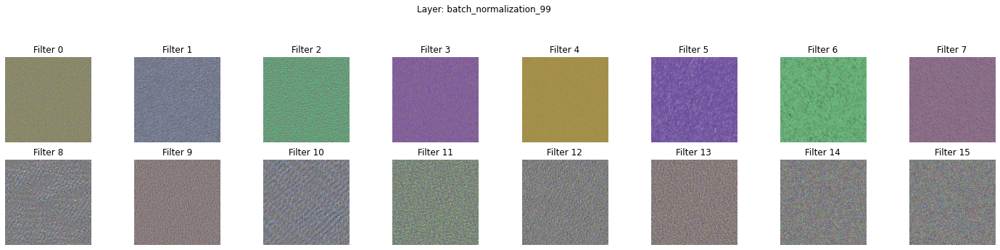

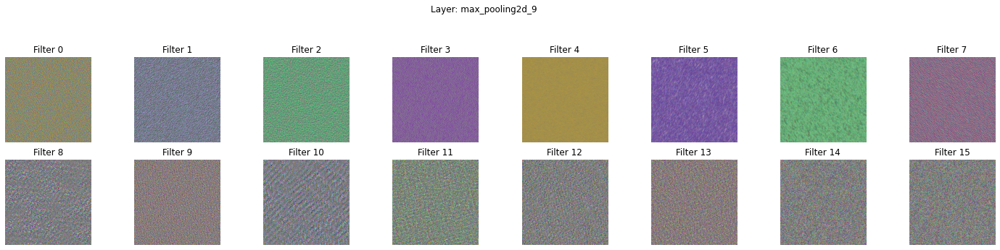

In [ ]:
for n in range(1,len(model.layers)-6):

  layer = model.get_layer(index = n)
  name = layer.name
  print(name)
  n_filters = layer.output_shape[-1]
  feature_extractor = keras.Model(inputs=model.inputs, outputs=layer.output)


  plt.figure(figsize=(25,10))
  for i in range(n_filters):
    loss, img = visualize_filter(i)
    plt.subplot(4,8,i+1)
    plt.title(f'Filter {i}')
    plt.suptitle(f'Layer: {name}')
    plt.imshow(img)
    plt.axis('off')

In [ ]:
!pip install tf-keras-vis

     |████████████████████████████████| 53 kB 1.4 MB/s 


conv2d_98
200/200 [==============================] - 24s 120ms/step - Score: 267.4427 - TotalVariation2D: 4.8168 - Norm: 55.5896


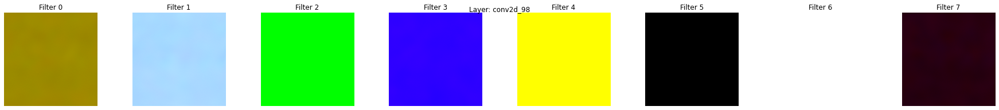

batch_normalization_96
200/200 [==============================] - 24s 122ms/step - Score: 264.9208 - TotalVariation2D: 5.1826 - Norm: 55.2432


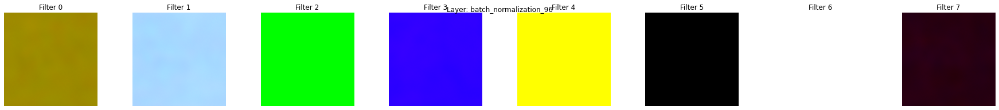

max_pooling2d_6
200/200 [==============================] - 24s 122ms/step - Score: 290.9315 - TotalVariation2D: 7.5460 - Norm: 58.7207


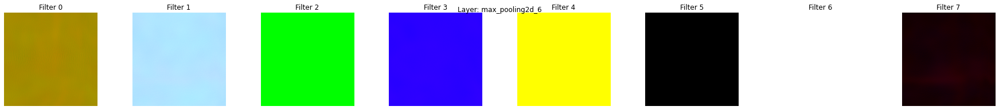

conv2d_99
200/200 [==============================] - 25s 125ms/step - Score: 290.5837 - TotalVariation2D: 6.4133 - Norm: 64.2005


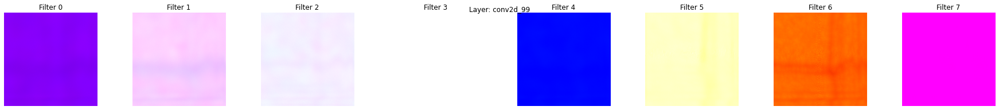

batch_normalization_97
200/200 [==============================] - 25s 127ms/step - Score: 289.7143 - TotalVariation2D: 6.1812 - Norm: 64.1471


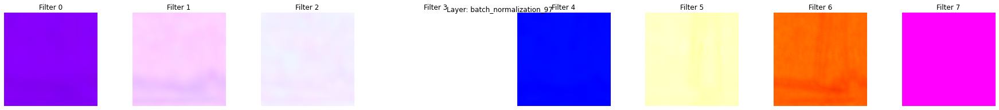

max_pooling2d_7
200/200 [==============================] - 25s 127ms/step - Score: 258.7797 - TotalVariation2D: 15.2232 - Norm: 53.8558


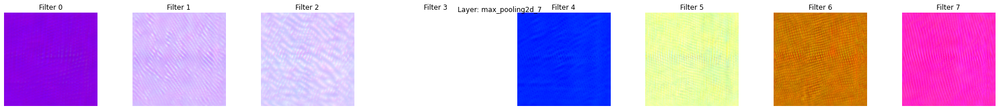

conv2d_100
200/200 [==============================] - 48s 238ms/step - Score: 77.8272 - TotalVariation2D: 8.0744 - Norm: 29.1542


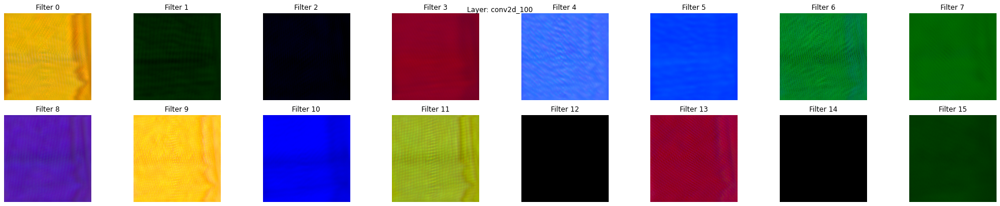

batch_normalization_98
200/200 [==============================] - 48s 238ms/step - Score: 78.1235 - TotalVariation2D: 8.2452 - Norm: 29.2108


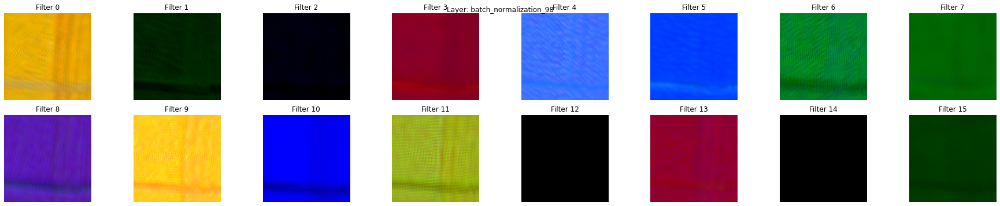

max_pooling2d_8
200/200 [==============================] - 47s 235ms/step - Score: 68.6475 - TotalVariation2D: 14.4481 - Norm: 30.1475


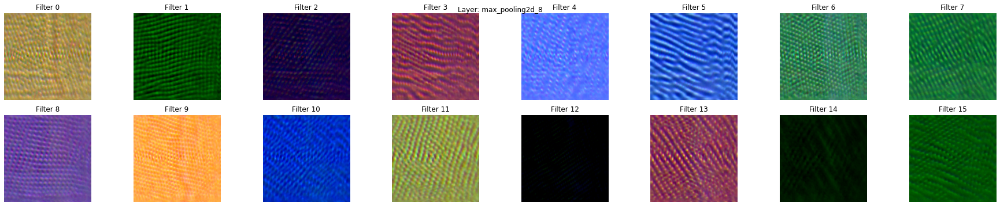

conv2d_101
200/200 [==============================] - 48s 239ms/step - Score: 110.3507 - TotalVariation2D: 11.9143 - Norm: 36.8854


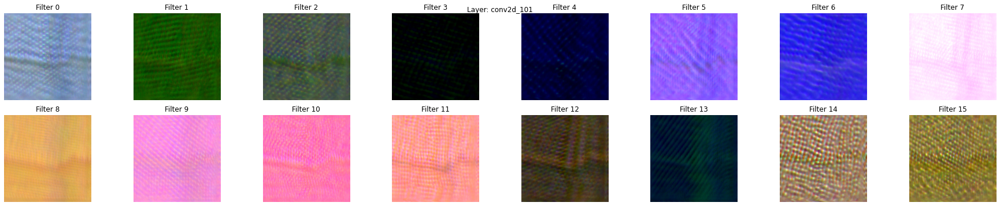

batch_normalization_99
200/200 [==============================] - 48s 241ms/step - Score: 109.2731 - TotalVariation2D: 11.7095 - Norm: 36.8732


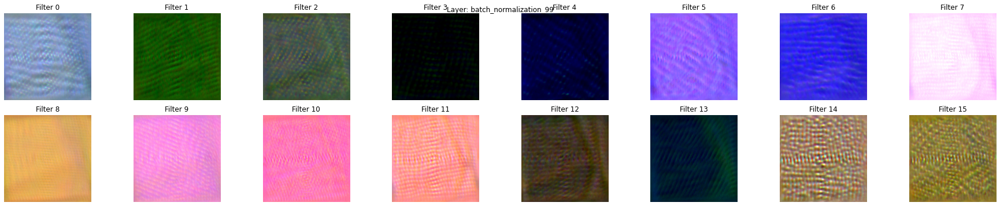

max_pooling2d_9
200/200 [==============================] - 48s 238ms/step - Score: 146.0920 - TotalVariation2D: 14.5802 - Norm: 38.2498


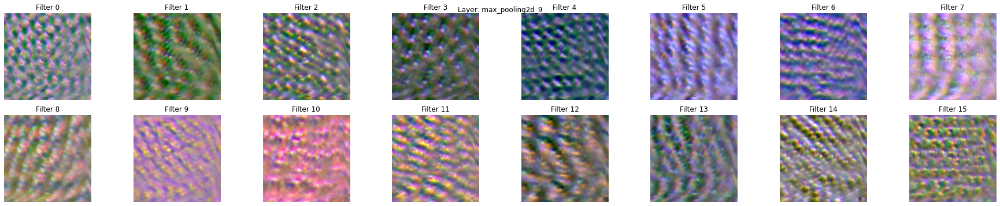

In [ ]:

from tf_keras_vis.activation_maximization import ActivationMaximization
from tf_keras_vis.utils.model_modifiers import ExtractIntermediateLayer, ReplaceToLinear
from tf_keras_vis.activation_maximization.callbacks import Progress
from tf_keras_vis.activation_maximization.input_modifiers import Jitter, Rotate2D
from tf_keras_vis.activation_maximization.regularizers import TotalVariation2D, Norm
from tf_keras_vis.utils.scores import CategoricalScore


for n in range(1,len(model.layers)-6):
  layer = model.get_layer(index = n)
  name = layer.name
  print(name)
  n_filters = layer.output_shape[-1]

  activation_maximization = ActivationMaximization(model,
                            model_modifier=[ExtractIntermediateLayer(name),
                                            ReplaceToLinear()],
                            clone=False)

  
  seed_input = tf.random.uniform((n_filters, 256, 256, 3), 0, 255)
  activations = activation_maximization(CategoricalScore(list(range(n_filters))),
                            seed_input=seed_input,
                            callbacks=[Progress()])

  plt.figure(figsize=(25,10))
  for i in range(n_filters):
    plt.subplot(4,8,i+1)
    plt.title(f'Filter {i}')
    plt.suptitle(f'Layer: {name}')
    plt.imshow(activations[i])
    plt.axis('off')
  plt.tight_layout()
  plt.show()

In [ ]:
model_meso1.summary()

Model: "model_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_5 (InputLayer)        [(None, 256, 256, 3)]     0         
                                                                 
 conv2d_102 (Conv2D)         (None, 256, 256, 16)      448       
                                                                 
 conv2d_103 (Conv2D)         (None, 256, 256, 4)       68        
                                                                 
 batch_normalization_100 (Ba  (None, 256, 256, 4)      16        
 tchNormalization)                                               
                                                                 
 max_pooling2d_10 (MaxPoolin  (None, 32, 32, 4)        0         
 g2D)                                                            
                                                                 
 flatten_3 (Flatten)         (None, 4096)              0   

conv2d_102
200/200 [==============================] - 44s 218ms/step - Score: 316.3942 - TotalVariation2D: 4.7893 - Norm: 55.5615


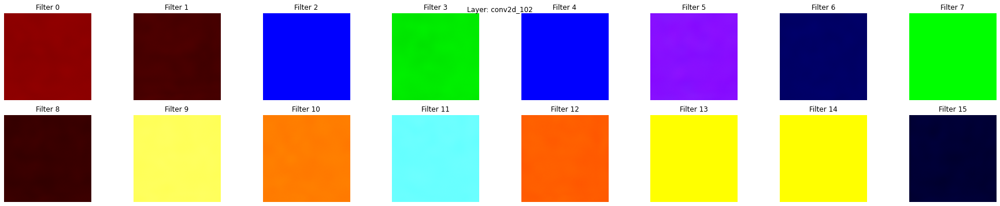

conv2d_103
200/200 [==============================] - 13s 64ms/step - Score: 820.0245 - TotalVariation2D: 4.4628 - Norm: 92.3256


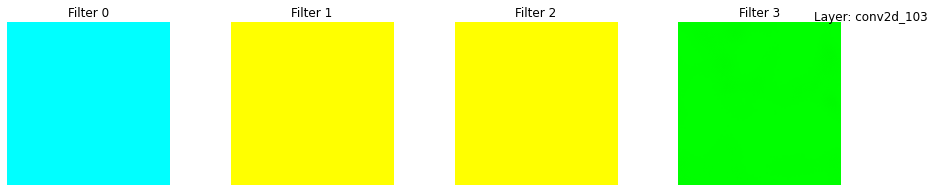

batch_normalization_100
200/200 [==============================] - 13s 67ms/step - Score: 2872.8484 - TotalVariation2D: 4.1308 - Norm: 81.3578


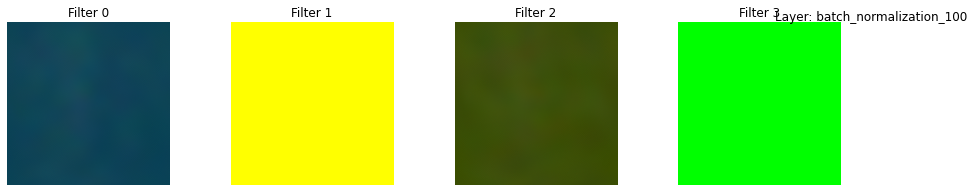

max_pooling2d_10
200/200 [==============================] - 13s 67ms/step - Score: 1058.2380 - TotalVariation2D: 15.2547 - Norm: 32.4477


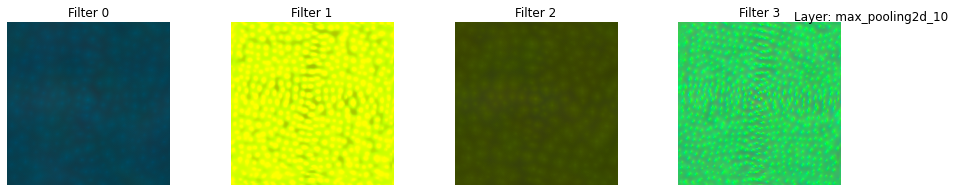

In [ ]:
for n in range(1,len(model_meso1.layers)-3):
  layer = model_meso1.get_layer(index = n)
  name = layer.name
  print(name)
  n_filters = layer.output_shape[-1]

  activation_maximization = ActivationMaximization(model_meso1,
                            model_modifier=[ExtractIntermediateLayer(name),
                                            ReplaceToLinear()],
                            clone=False)

  
  seed_input = tf.random.uniform((n_filters, 256, 256, 3), 0, 255)
  activations = activation_maximization(CategoricalScore(list(range(n_filters))),
                            seed_input=seed_input,
                            callbacks=[Progress()])

  plt.figure(figsize=(25,10))
  for i in range(n_filters):
    plt.subplot(4,8,i+1)
    plt.title(f'Filter {i}')
    plt.suptitle(f'Layer: {name}')
    plt.imshow(activations[i])
    plt.axis('off')
  plt.tight_layout()
  plt.show()

In [ ]:
model_meso4.summary()

Model: "model_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_6 (InputLayer)        [(None, 256, 256, 3)]     0         
                                                                 
 conv2d_104 (Conv2D)         (None, 256, 256, 8)       224       
                                                                 
 batch_normalization_101 (Ba  (None, 256, 256, 8)      32        
 tchNormalization)                                               
                                                                 
 max_pooling2d_11 (MaxPoolin  (None, 128, 128, 8)      0         
 g2D)                                                            
                                                                 
 conv2d_105 (Conv2D)         (None, 128, 128, 8)       1608      
                                                                 
 batch_normalization_102 (Ba  (None, 128, 128, 8)      32  

conv2d_104
200/200 [==============================] - 24s 121ms/step - Score: 247.4603 - TotalVariation2D: 4.7376 - Norm: 52.5177


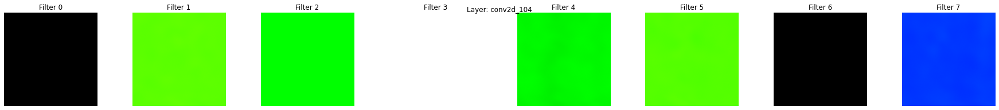

batch_normalization_101
200/200 [==============================] - 24s 120ms/step - Score: 3655.3093 - TotalVariation2D: 5.0275 - Norm: 50.6881


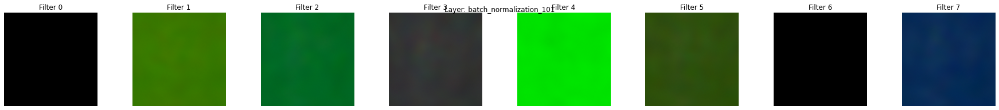

max_pooling2d_11
200/200 [==============================] - 24s 120ms/step - Score: 1675.5656 - TotalVariation2D: 9.2811 - Norm: 32.3052


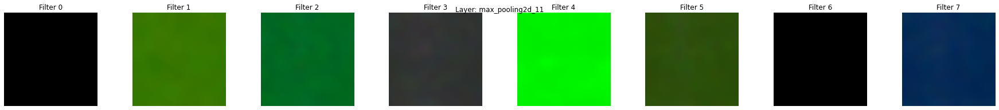

conv2d_105
200/200 [==============================] - 25s 124ms/step - Score: 5261.9370 - TotalVariation2D: 13.8722 - Norm: 69.2693


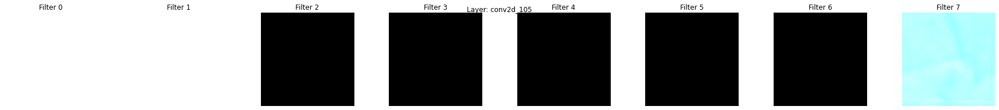

batch_normalization_102
200/200 [==============================] - 25s 126ms/step - Score: 6986.5835 - TotalVariation2D: 15.0631 - Norm: 69.4280


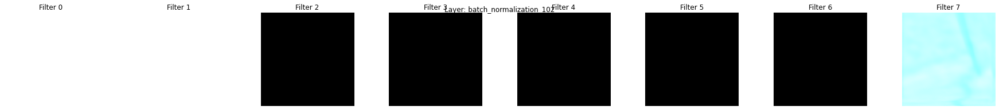

max_pooling2d_12
200/200 [==============================] - 25s 126ms/step - Score: 5123.8604 - TotalVariation2D: 25.3176 - Norm: 41.3802


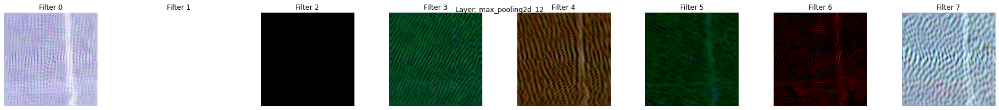

conv2d_106
200/200 [==============================] - 47s 236ms/step - Score: 4427.6548 - TotalVariation2D: 13.6250 - Norm: 51.2228


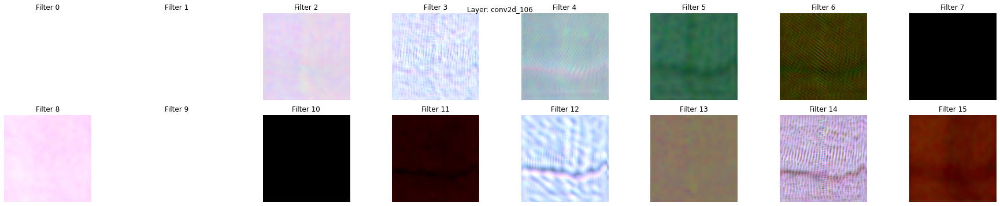

batch_normalization_103
200/200 [==============================] - 47s 236ms/step - Score: 4762.5913 - TotalVariation2D: 14.6440 - Norm: 51.2228


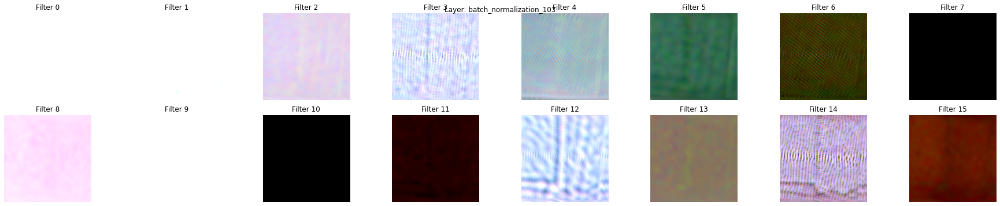

max_pooling2d_13
200/200 [==============================] - 47s 237ms/step - Score: 4548.4521 - TotalVariation2D: 18.0185 - Norm: 46.1630


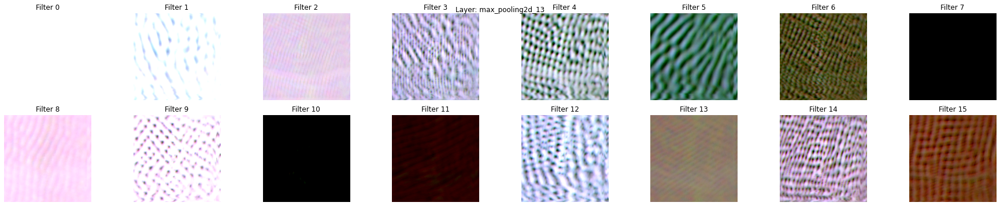

conv2d_107
200/200 [==============================] - 47s 236ms/step - Score: 6274.9932 - TotalVariation2D: 17.8719 - Norm: 34.4054


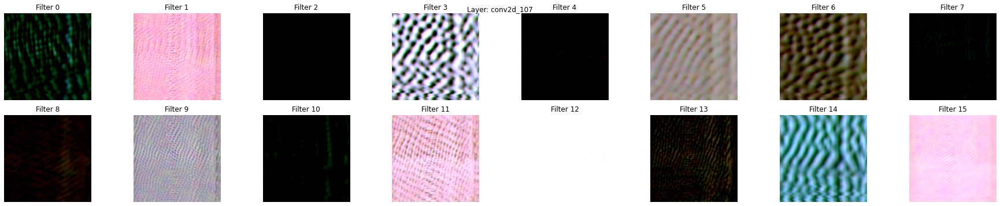

batch_normalization_104
200/200 [==============================] - 48s 239ms/step - Score: 3283.9868 - TotalVariation2D: 17.2222 - Norm: 34.3883


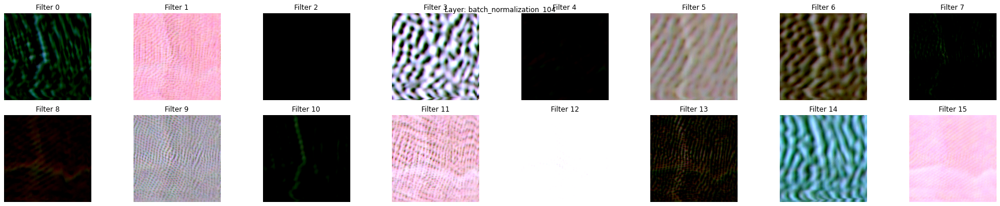

max_pooling2d_14
200/200 [==============================] - 48s 238ms/step - Score: 6583.9966 - TotalVariation2D: 20.2570 - Norm: 38.3140


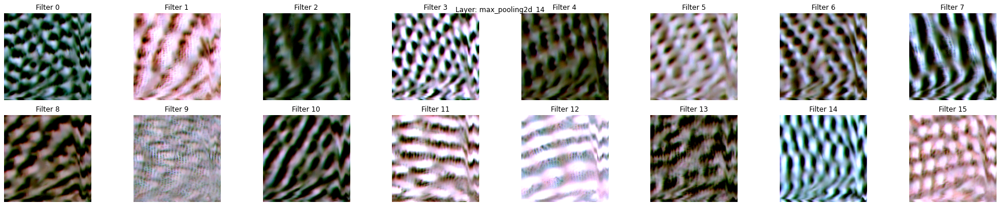

In [ ]:
for n in range(1,len(model_meso4.layers)-6):
  layer = model_meso4.get_layer(index = n)
  name = layer.name
  print(name)
  n_filters = layer.output_shape[-1]

  activation_maximization = ActivationMaximization(model_meso4,
                            model_modifier=[ExtractIntermediateLayer(name),
                                            ReplaceToLinear()],
                            clone=False)

  
  seed_input = tf.random.uniform((n_filters, 256, 256, 3), 0, 255)
  activations = activation_maximization(CategoricalScore(list(range(n_filters))),
                            seed_input=seed_input,
                            callbacks=[Progress()])

  plt.figure(figsize=(25,10))
  for i in range(n_filters):
    plt.subplot(4,8,i+1)
    plt.title(f'Filter {i}')
    plt.suptitle(f'Layer: {name}')
    plt.imshow(activations[i])
    plt.axis('off')
  plt.tight_layout()
  plt.show()

In [ ]:
model_mesoinception4.summary()

Model: "model_6"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_7 (InputLayer)           [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d_109 (Conv2D)            (None, 256, 256, 4)  16          ['input_7[0][0]']                
                                                                                                  
 conv2d_111 (Conv2D)            (None, 256, 256, 4)  16          ['input_7[0][0]']                
                                                                                                  
 conv2d_113 (Conv2D)            (None, 256, 256, 2)  8           ['input_7[0][0]']          

conv2d_109
200/200 [==============================] - 12s 62ms/step - Score: 420.8951 - TotalVariation2D: 4.6926 - Norm: 75.2384


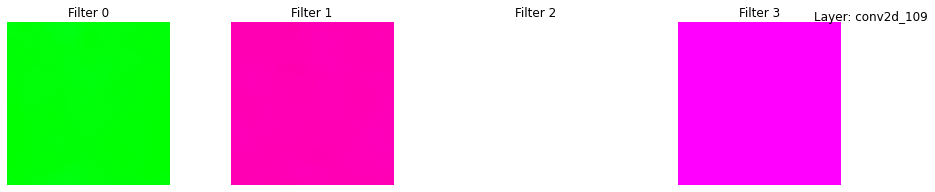

conv2d_111
200/200 [==============================] - 13s 63ms/step - Score: 345.2306 - TotalVariation2D: 5.2837 - Norm: 61.4150


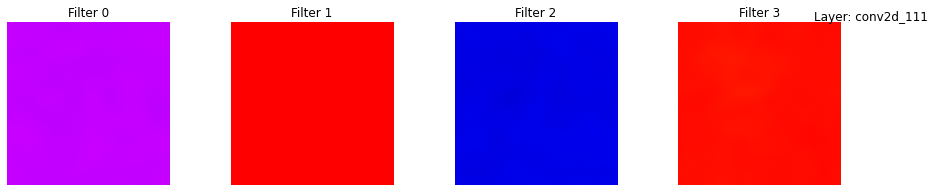

conv2d_113
200/200 [==============================] - 7s 37ms/step - Score: 415.3249 - TotalVariation2D: 4.6681 - Norm: 68.9250


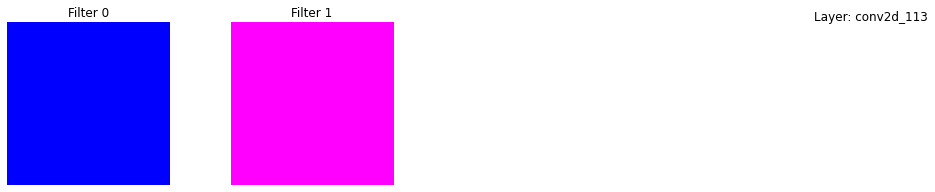

conv2d_108
200/200 [==============================] - 5s 25ms/step - Score: 574.4171 - TotalVariation2D: 4.7607 - Norm: 72.4232


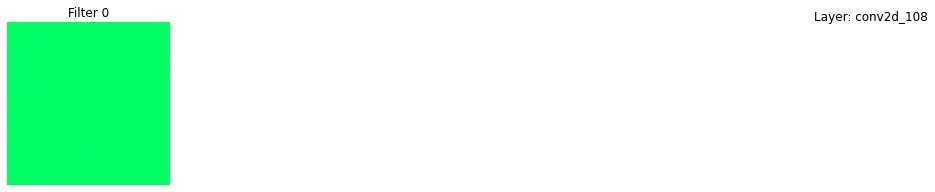

conv2d_110
200/200 [==============================] - 14s 69ms/step - Score: 953.0598 - TotalVariation2D: 4.2371 - Norm: 87.5595


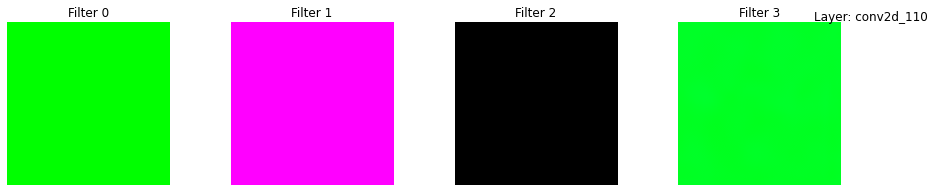

conv2d_112
200/200 [==============================] - 14s 67ms/step - Score: 274.6895 - TotalVariation2D: 4.6732 - Norm: 47.4589


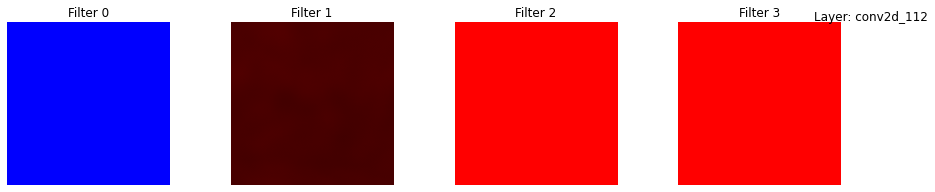

conv2d_114
200/200 [==============================] - 8s 40ms/step - Score: 514.9476 - TotalVariation2D: 4.4533 - Norm: 69.0660


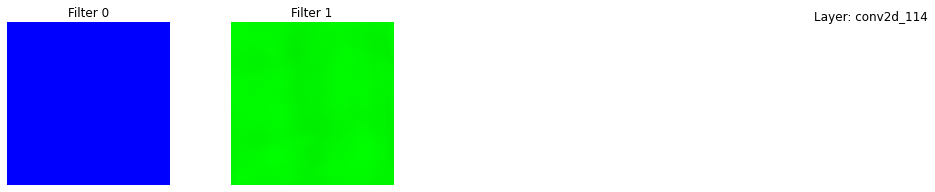

concatenate_2
 95/200 [=============>................] - ETA: 18s - Score: 374.0919 - TotalVariation2D: 6.8920 - Norm: 48.2155

In [ ]:
for n in range(1,len(model_mesoinception4.layers)-6):
  layer = model_mesoinception4.get_layer(index = n)
  name = layer.name
  print(name)
  n_filters = layer.output_shape[-1]

  activation_maximization = ActivationMaximization(model_mesoinception4,
                            model_modifier=[ExtractIntermediateLayer(name),
                                            ReplaceToLinear()],
                            clone=False)

  
  seed_input = tf.random.uniform((n_filters, 256, 256, 3), 0, 255)
  activations = activation_maximization(CategoricalScore(list(range(n_filters))),
                            seed_input=seed_input,
                            callbacks=[Progress()])

  plt.figure(figsize=(25,10))
  n_plots = min(16,n_filters)
  for i in range(n_plots):
    plt.subplot(4,8,i+1)
    plt.title(f'Filter {i}')
    plt.suptitle(f'Layer: {name}')
    plt.imshow(activations[i])
    plt.axis('off')
  plt.tight_layout()
  plt.show()